In [1]:
import numpy as np
import matplotlib.pyplot as plt
from camutils import Camera,triangulate
import pickle
import visutils
import matplotlib.patches as patches
from mpl_toolkits.mplot3d import Axes3D
import cv2
from camutils import makerotation,Camera,triangulate,calibratePose,decode
import scipy.spatial
from meshutils import writeply
import trimesh
%matplotlib inline

### Step 1

Use the code from assginment 2.

Camera : 
 f=1404.6009661788062 
 c=[[962.16736916 590.91595682]] 
 R=[[-0.00259871  0.99096865  0.13406854]
 [ 0.99277875 -0.01352251  0.1191952 ]
 [ 0.11993165  0.13341015 -0.98377748]] 
 t = [[ 7.50010665  7.20926303 47.76495312]]
Camera : 
 f=1404.6009661788062 
 c=[[962.16736916 590.91595682]] 
 R=[[ 0.03843674  0.98947412  0.13951197]
 [ 0.9773577  -0.00815434 -0.21143659]
 [-0.2080734   0.14448003 -0.96738357]] 
 t = [[ 6.86588621 19.52347137 47.34419123]]


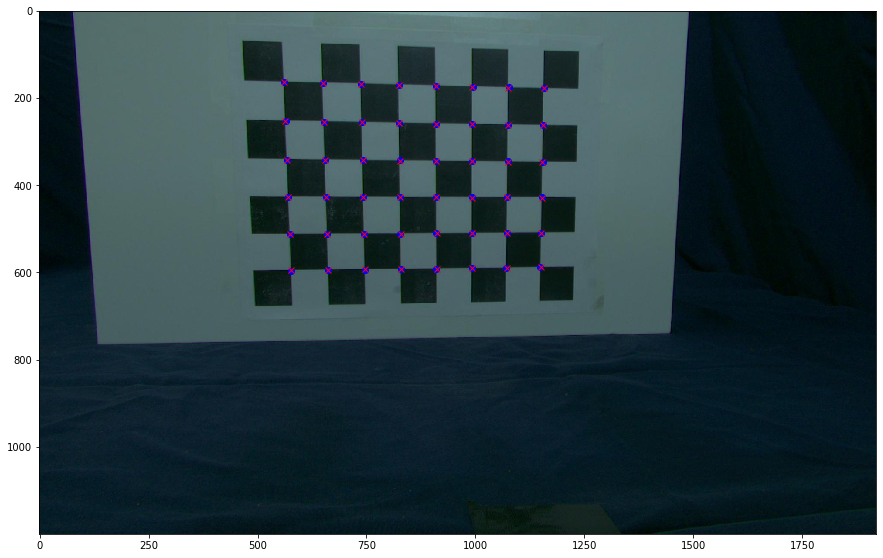

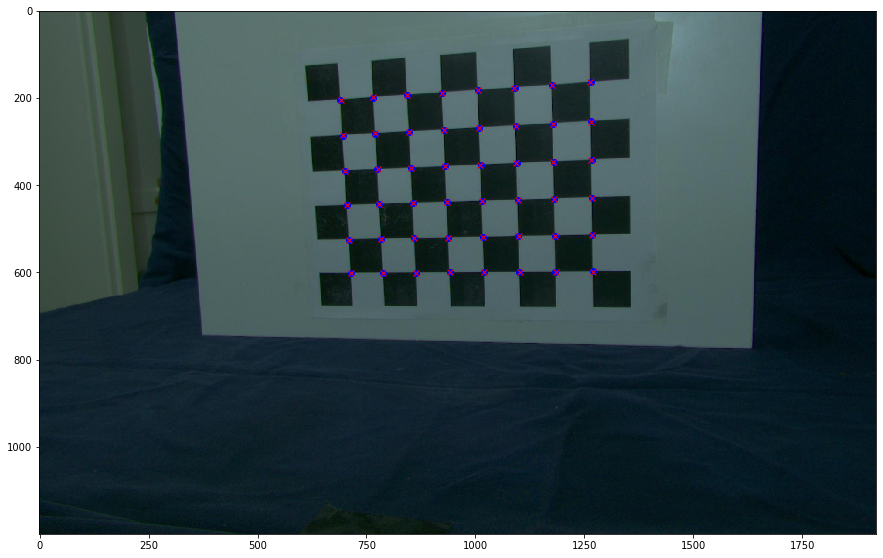

In [2]:
# load in the intrinsic camera parameters from 'calibration.pickle'
params = np.load('calibration.pickle',allow_pickle=True)

# create Camera objects representing the left and right cameras
# use the known intrinsic parameters you loaded in.

# set f to be the average of the two estimated by the script
f = (params['fx'] + params['fy'])/2
c = np.array([[params['cx'],params['cy']]]).T
t = np.zeros((3,1))
R = np.zeros((3,3))

camL = Camera(f,c,R,t)
camR = Camera(f,c,R,t)

# load in the left and right images and find the coordinates of
# the chessboard corners using OpenCV
imgL = plt.imread('calib_jpg_u/frame_C1_01.jpg')
ret, cornersL = cv2.findChessboardCorners(imgL, (8,6), None)
pts2L = cornersL.squeeze().T

imgR = plt.imread('calib_jpg_u/frame_C0_01.jpg')
ret, cornersR = cv2.findChessboardCorners(imgR, (8,6), None)
pts2R = cornersR.squeeze().T

# generate the known 3D point coordinates of points on the checkerboard in cm
pts3 = np.zeros((3,6*8))
yy,xx = np.meshgrid(np.arange(8),np.arange(6))
pts3[0,:] = 2.8*xx.reshape(1,-1)
pts3[1,:] = 2.8*yy.reshape(1,-1)


# Now use your calibratePose function to get the extrinsic parameters
# for the two images. You may need to experiment with the initialization
# in order to get a good result
params_init = np.array([0,0,0,0,0,-2]) 

camL = calibratePose(pts3,pts2L,camL,params_init)
camR = calibratePose(pts3,pts2R,camR,params_init)

print(camL)
print(camR)

# As a final test, triangulate the corners of the checkerboard 
# to get back there 3D locations
pts3r = triangulate(pts2L,camL,pts2R,camR)

# Display the reprojected points overlayed on the images to make 
# sure they line up
plt.rcParams['figure.figsize']=[15,15]
pts2Lp = camL.project(pts3)
plt.imshow(imgL)
plt.plot(pts2Lp[0,:],pts2Lp[1,:],'bo')
plt.plot(pts2L[0,:],pts2L[1,:],'rx')
plt.show()

pts2Rp = camR.project(pts3)
plt.imshow(imgR)
plt.plot(pts2Rp[0,:],pts2Rp[1,:],'bo')
plt.plot(pts2R[0,:],pts2R[1,:],'rx')
plt.show()

### Step 2

Use and modify the code by the instructor.

In [3]:
def reconstruct(imprefix,imprefixL,imprefixR,threshold,camL,camR):
    """
    Performing matching and triangulation of points on the surface using structured
    illumination. This function decodes the binary graycode patterns, matches 
    pixels with corresponding codes, and triangulates the result.
    
    The returned arrays include 2D and 3D coordinates of only those pixels which
    were triangulated where pts3[:,i] is the 3D coordinte produced by triangulating
    pts2L[:,i] and pts2R[:,i]

    Parameters
    ----------
    imprefixL, imprefixR : str
        Image prefixes for the coded images from the left and right camera
        
    threshold : float
        Threshold to determine if a bit is decodeable
   
    camL,camR : Camera
        Calibration info for the left and right cameras
        
    Returns
    -------
    pts2L,pts2R : 2D numpy.array (dtype=float)
        The 2D pixel coordinates of the matched pixels in the left and right
        image stored in arrays of shape 2xN
        
    pts3 : 2D numpy.array (dtype=float)
        Triangulated 3D coordinates stored in an array of shape 3xN
        
    """
    # Load in foreground and background color images
    BgL = plt.imread(imprefix + "/color_C1_00.png")
    BgR = plt.imread(imprefix + "/color_C0_00.png")
    FgL = plt.imread(imprefix + "/color_C1_01.png")
    FgR = plt.imread(imprefix + "/color_C0_01.png")

    # compute an object mask 
    # threshold the difference of object and background
    LOmask = np.abs(FgL-BgL)>threshold
    ROmask = np.abs(FgR-BgR)>threshold
    
    #convert to float data type and scale to [0..1] if necessary
    if (LOmask.dtype == np.uint8):
        LOmask = LOmask.astype(float) / 256
        ROmask = ROmask.astype(float) / 256
        
    #if mask is color (shape HxWx3), convert to grayscale
    if (len(LOmask.shape)>2):
        LOmask = np.mean(LOmask,axis=2)
        ROmask = np.mean(ROmask,axis=2)   

    # Decode the H and V coordinates for the two views
    CLh,maskLh = decode(imprefixL,0,threshold)
    CLv,maskLv = decode(imprefixL,20,threshold)
    CRh,maskRh = decode(imprefixR,0,threshold)
    CRv,maskRv = decode(imprefixR,20,threshold)

    # Construct the combined 20 bit code C = H + 1024*V and mask for each view
    # Combine object mask with decoding mask
    CL = CLh + 1024 * CLv
    maskL = maskLh * maskLv * LOmask
    
    CR = CRh + 1024 * CRv
    maskR = maskRh * maskRv * ROmask
    
    # mask the undecodable
    h = CR.shape[0]
    w = CR.shape[1]

    subR = np.nonzero(maskR.flatten())
    subL = np.nonzero(maskL.flatten())

    CRgood = CR.flatten()[subR]
    CLgood = CL.flatten()[subL]
    
    # Find the indices of pixels in the left and right code image that 
    # have matching codes. If there are multiple matches, just
    # choose one arbitrarily.
    _,submatchR,submatchL = np.intersect1d(CRgood,CLgood,return_indices=True)

    matchR = subR[0][submatchR]
    matchL = subL[0][submatchL]
    

    # Let CL and CR be the flattened arrays of codes for the left and right view
    # Suppose you have computed arrays of indices matchL and matchR so that 
    # CL[matchL[i]] == CR[matchR[i]] for all i.  The code below gives one approach
    # to generating the corresponding pixel coordinates for the matched pixels.
    
    xx,yy = np.meshgrid(range(w),range(h))
    xx = np.reshape(xx,(-1,1))
    yy = np.reshape(yy,(-1,1))
    pts2R = np.concatenate((xx[matchR].T,yy[matchR].T),axis=0)
    pts2L = np.concatenate((xx[matchL].T,yy[matchL].T),axis=0)

    # Now triangulate the points
    pts3 = triangulate(pts2L,camL,pts2R,camR)
    
    # Record the color of the corresponding pixel in color img
    # shape 3xN (N = # of points)
    colors = FgL[pts2L[1,:],pts2L[0,:],:].T
    
    return pts2L,pts2R,pts3,colors

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



Text(0, 0.5, 'y')

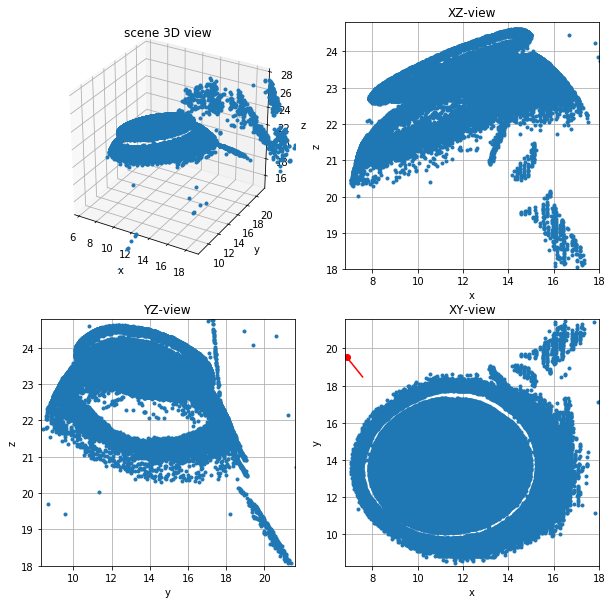

In [4]:
#
# Reconstruct and visualize the results
#
scan_dir = "teapot/grab_6_u"
imprefix = scan_dir
imprefixL = scan_dir + "/frame_C1_"
imprefixR = scan_dir + "/frame_C0_"
threshold = 0.02

pts2L,pts2R,pts3,colors = reconstruct(imprefix,imprefixL,imprefixR,threshold,camL,camR)

# Add your visualization code here.  As we have done previously it is good to visualize different
# 2D projections XY, XZ, YZ and well as a 3D version

# generate coordinates of a line segment running from the center
# of the camera to 3 units in front of the camera
lookL = np.hstack((camL.t,camL.t+camL.R @ np.array([[0,0,5]]).T))
lookR = np.hstack((camR.t,camR.t+camR.R @ np.array([[0,0,5]]).T))

# visualize the left and right image overlaid
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(2,2,1,projection='3d')
ax.set_xlim3d(6.8, 18)
ax.set_ylim3d(8.3, 21.6)
ax.set_zlim3d(18, 24.8)
ax.plot(pts3[0,:],pts3[1,:],pts3[2,:],'.')
ax.plot(camR.t[0],camR.t[1],camR.t[2],'ro')
ax.plot(camL.t[0],camL.t[1],camL.t[2],'bo')
ax.plot(lookL[0,:],lookL[1,:],lookL[2,:],'b')
ax.plot(lookR[0,:],lookR[1,:],lookR[2,:],'r')
visutils.set_axes_equal_3d(ax)
visutils.label_axes(ax)
plt.title('scene 3D view')

ax = fig.add_subplot(2,2,2)
ax.set_xlim(6.8, 18)
ax.set_ylim(18, 24.8)
ax.plot(pts3[0,:],pts3[2,:],'.')
ax.plot(camR.t[0],camR.t[2],'ro')
ax.plot(camL.t[0],camL.t[2],'bo')
ax.plot(lookL[0,:],lookL[2,:],'b')
ax.plot(lookR[0,:],lookR[2,:],'r')
plt.title('XZ-view')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(2,2,3)
ax.set_xlim(8.3, 21.6)
ax.set_ylim(18, 24.8)
ax.plot(pts3[1,:],pts3[2,:],'.')
ax.plot(camR.t[1],camR.t[2],'ro')
ax.plot(camL.t[1],camL.t[2],'bo')
ax.plot(lookL[1,:],lookL[2,:],'b')
ax.plot(lookR[1,:],lookR[2,:],'r')
plt.title('YZ-view')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(2,2,4)
ax.set_xlim(6.8, 18)
ax.set_ylim(8.3, 21.6)
ax.plot(pts3[0,:],pts3[1,:],'.')
ax.plot(camR.t[0],camR.t[1],'ro')
ax.plot(camL.t[0],camL.t[1],'bo')
ax.plot(lookL[0,:],lookL[1,:],'b')
ax.plot(lookR[0,:],lookR[1,:],'r')
plt.title('XY-view')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

### Step 3

find_neigbors function is from this link: https://stackoverflow.com/questions/12374781/how-to-find-all-neighbors-of-a-given-point-in-a-delaunay-triangulation-using-sci

In [5]:
from collections import defaultdict

def find_neighbors(tri):
    neighbors = defaultdict(set)

    for simplex in tri:
        for idx in simplex:
            other = set(simplex)
            other.remove(idx)
            neighbors[idx] = neighbors[idx].union(other)
    return neighbors

In [6]:
def mesh_smoothing(tri,pts3,k):
    n = find_neighbors(tri)
    p = pts3.T
    for j in range(k):
        for i in range(p.shape[0]):
            p[i] = np.mean(p[np.array(list(n[i])).astype(np.int32)],axis=0)
    pts3 = p.T
    return pts3

In [7]:
def mesh_generate(scan_dir,pose,camL,camR,threshold,boxlimits,trithresh,pickle_file):

    # Reconstruct points
    imprefix = scan_dir + "/grab_" + str(pose) + "_u"
    imprefixL = imprefix + "/frame_C1_"
    imprefixR = imprefix + "/frame_C0_"
    pts2L,pts2R,pts3,colors = reconstruct(imprefix,imprefixL,imprefixR,threshold,camL,camR)
    
    # Bounding box pruning
    pts = np.nonzero((pts3[0]>boxlimits[0])&\
                    (pts3[0]<boxlimits[1])&\
                    (pts3[1]>boxlimits[2])&\
                    (pts3[1]<boxlimits[3])&\
                    (pts3[2]>boxlimits[4])&\
                    (pts3[2]<boxlimits[5]))

    pts3 = pts3[:,pts[0]]
    pts2L = pts2L[:,pts[0]]
    pts2R = pts2R[:,pts[0]]
    colors = colors[:,pts[0]]
    
    # Triangulate the 2D points to get the surface mesh
    T = scipy.spatial.Delaunay(pts2L.T)
    tri = T.simplices

    # Triangle pruning

    # Edges in triangles
    a = np.linalg.norm(pts3[:,tri[:,0]]-pts3[:,tri[:,1]],axis=0)
    b = np.linalg.norm(pts3[:,tri[:,0]]-pts3[:,tri[:,2]],axis=0)
    c = np.linalg.norm(pts3[:,tri[:,1]]-pts3[:,tri[:,2]],axis=0)

    tri_thre = (a<trithresh)&(b<trithresh)&(c<trithresh)

    tri = tri[tri_thre,:]

    # Remove any points which are not refenced in any triangle

    # vertices to keep
    keep = np.unique(tri)

    # index of triangles
    index_map = np.zeros(pts3.shape[1])
    index_map[keep] = np.arange(keep.shape[0])
    tri = index_map[tri]

    pts3 = pts3[:,keep]
    pts2L = pts2L[:,keep]
    pts2R = pts2R[:,keep]
    colors = colors[:,keep]
    
    
    # mesh smoothing for 2 times
    pts3 =  mesh_smoothing(tri,pts3,2)
    
    
    # Save out a triangulated mesh to a ply file for Meshlab
    filename = "mesh/pose" + str(pose) + ".ply"
    writeply(pts3,colors,tri,filename)
    
    # Store the results in a pickle file
    mesh = {}
    mesh["pts2L"] = pts2L
    mesh["pts2R"] = pts2R
    mesh["pts3"] = pts3
    mesh["colors"] = colors
    mesh["tri"] = tri
    
    fid = open(pickle_file, "wb" ) 
    pickle.dump(mesh,fid)
    fid.close()
    

### Step 4 

In [16]:
# Mesh generation 0
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([-5,19,2.5,22.5,18.5,26.1])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 1.5

# generate mesh for 7 poses of teapot
n_pose = 7

i = 0
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



In [17]:
# load in the computation results from mesh generation
params = np.load('mesh/pose0.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [59]:
# Mesh generation 1
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([-5,18.8,6,18,19,27.6])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 1

# generate mesh for 7 poses of teapot
n_pose = 7

i = 1
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

# load in the computation results from mesh generation
params = np.load('mesh/pose1.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



In [60]:
# Mesh generation 2
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([-5,19,2,21.5,18.5,25.6])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 2

# generate mesh for 7 poses of teapot
n_pose = 7

i = 2
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

# load in the computation results from mesh generation
params = np.load('mesh/pose2.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



In [61]:
# Mesh generation 3
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([0,19,7.2,17.5,15,24.3])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 0.8

# generate mesh for 7 poses of teapot
n_pose = 7

i = 3
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

# load in the computation results from mesh generation
params = np.load('mesh/pose3.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



In [62]:
# Mesh generation 4
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([-0.2,19,4.7,21.4,15,25])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 0.7

# generate mesh for 7 poses of teapot
n_pose = 7

i = 4
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

# load in the computation results from mesh generation
params = np.load('mesh/pose4.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



In [63]:
# Mesh generation 5
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([7,18,4.7,23.5,10,25.6])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 2

# generate mesh for 7 poses of teapot
n_pose = 7

i = 5
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

# load in the computation results from mesh generation
params = np.load('mesh/pose5.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )



In [64]:
# Mesh generation 6
scan_dir = "teapot/"
threshold = 0.02

# Specify limits along the x,y and z axis of a box containing the object
# we will prune out triangulated points outside these limits
boxlimits = np.array([6.8,18,8.3,21.6,18,24.8])

# Specify a longest allowed edge that can appear in the mesh. Remove triangles
# from the final mesh that have edges longer than this value
trithresh = 2

# generate mesh for 7 poses of teapot
n_pose = 7

i = 6
pickle_file = "mesh/pose" + str(i) + ".pickle"
mesh_generate(scan_dir,i,camL,camR,threshold,boxlimits,trithresh,pickle_file)

# load in the computation results from mesh generation
params = np.load('mesh/pose6.pickle',allow_pickle=True)
pts3 = params["pts3"]
tri = params["tri"]
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

